In [1]:
import os
import datetime as dt
import numpy as np
import pandas as pd
import factoroid as fr
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import warnings
warnings.filterwarnings('ignore')

WebSQL = fr.connector.MySQLDB('db-01')
DevSQL = fr.connector.MySQLDB('db-dev')

Successfully connected; Factorid web services
Successfully connected; Factoroid development


In [2]:
from model.utils_function import *
from model.utils_cycle import *
from model.utils_output import *
from model.utils_main import *
from model.utils_preprocessor import *

In [3]:
now = dt.datetime(2022, 4, 2, 8)
# now = dt.datetime.now().replace(hour=8, minute=0, second=0, microsecond=0)

In [4]:
str_datetime = str(now.date())
if not os.path.exists(f'./images/{str_datetime}'):
    os.mkdir(f'./images/{str_datetime}')

In [5]:
# SO data load
# SO data merge

so = pd.DataFrame(WebSQL.query(f'''
                                    SELECT stop.equipment_name AS equipment_name, stop.order_number AS so, stop.gop AS gop, stop.material AS material, stop.qty AS qty, start.report_date AS start_time, MAX(stop.report_date) AS stop_time
                                    FROM so_log_yulkok AS stop
                                    LEFT JOIN (SELECT equipment_name, order_number, gop, material, qty, MIN(report_date) AS report_date
                                            FROM so_log_yulkok
                                            WHERE equipment_name IN ('G3020 #1', 'CMI 3S #8', 'DMC60T#3', 'DMU 50 3rd Generation #2', 'ECOSPEED F1040 #2', 'EVER 7', 
                                                                     'FMS ZT-800 #3', 'H5-800', 'HFP1540 PROTO', 'HU80A-5X', 'KT MODU LINE #3', 'MC18200 #1',
                                                                     'MP2150', 'MYNX500#1', 'SB-416', 'SNK RB-200F(2060)', 'VC630/5AX #S4', 'VMP8-6P', 'YK 3070(TCP-30TS)')
                                            AND status = '보고시작' AND report_date >= '{str(now - dt.timedelta(days=7))}' AND report_date <= '{str(now)}'
                                            GROUP BY equipment_name, order_number, gop, material, qty) AS start
                                            ON stop.equipment_name = start.equipment_name AND stop.order_number = start.order_number AND stop.gop = start.gop AND stop.material = start.material AND stop.qty = start.qty
                                    WHERE stop.equipment_name IN ('G3020 #1', 'CMI 3S #8', 'DMC60T#3', 'DMU 50 3rd Generation #2', 'ECOSPEED F1040 #2', 'EVER 7', 
                                                                  'FMS ZT-800 #3', 'H5-800', 'HFP1540 PROTO', 'HU80A-5X', 'KT MODU LINE #3', 'MC18200 #1',
                                                                  'MP2150', 'MYNX500#1', 'SB-416', 'SNK RB-200F(2060)', 'VC630/5AX #S4', 'VMP8-6P', 'YK 3070(TCP-30TS)')
                                    AND stop.status = '보고완료' AND stop.completion_flag = 'X' AND stop.report_date >= '{str(now - dt.timedelta(days=1))}' AND stop.report_date < '{str(now)}'
                                    GROUP BY equipment_name, so, gop, material, qty;
                                '''), columns=['equipment_name', 'so', 'gop', 'material', 'qty', 'start_time', 'stop_time', 'total_runtime'])

so.total_runtime = round((so.stop_time - so.start_time) / np.timedelta64(1,'h'), 3)
so = so.dropna().sort_values(by=['equipment_name', 'start_time']).reset_index(drop=True)

In [6]:
cycle_summary = pd.DataFrame(columns=['factory_id', 'process_id', 'equipment_id', 'equipment_name', 
                                      'material', 'so', 'gop', 'qty', 'cycle_number', 'start_time', 'stop_time',
                                      'spindle', 'idle_inter', 'total'])

In [7]:
so_g = so.groupby(['equipment_name'])
so_g_keys = list(so_g.groups.keys())
if not so_g_keys:
    print('Not found SO data')
else:
    print(f'machine\nSO data length: {so.shape[0]}\n{", ".join(so_g_keys)}')

machine
SO data length: 44
CMI 3S #8, DMC60T#3, DMU 50 3rd Generation #2, ECOSPEED F1040 #2, EVER 7, FMS ZT-800 #3, G3020 #1, HFP1540 PROTO, HU80A-5X, KT MODU LINE #3, MP2150, SB-416, SNK RB-200F(2060), VMP8-6P, YK 3070(TCP-30TS)


In [8]:
machine = 'FMS ZT-800 #3'
so_df_ = so_g.get_group(machine).reset_index(drop=True)
so_df_ = so_df_[so_df_.total_runtime > 0.1]
stop_times = list(so_df_.stop_time.values)
print(machine)
print(f'DataFrame Length: {so_df_.shape[0]}')
so_df_

FMS ZT-800 #3
DataFrame Length: 1


,equipment_name,so,gop,material,qty,start_time,stop_time,total_runtime
0,FMS ZT-800 #3,D200595630,20,116W2217-605,2,2022-03-31 16:15:19,2022-04-01 16:57:32,24.704



        DMU 50 3rd Generation #2	Y200160800	50	315A6156-73	80      2022-03-30 21:12:54 ~ 2022-04-01 18:00:23
        
too big [62742, 63054] 2022-04-01T13:04:05.000000000 2022-04-01T12:03:13.000000000 3652.0


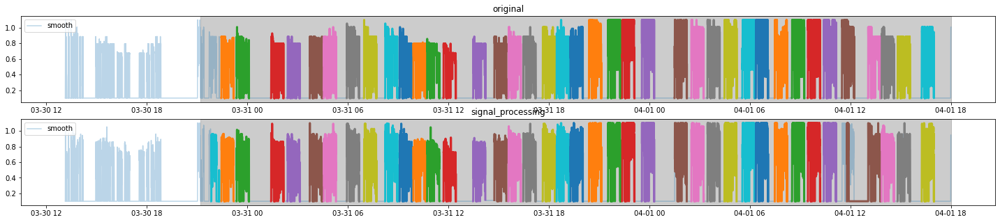

In [13]:
# index_, plotting, company = 0, True, 'yg'
plotting, company = False, 'yg'
config.plot = plotting
config.company = company

data_dict = {}

index_ = 2
so_index = 0
for machine in so_g_keys[index_:index_+1]:
    so_df_ = so_g.get_group(machine).reset_index(drop=True)
    so_df_ = so_df_[so_df_.total_runtime > 0.1]
    stop_times = list(so_df_.stop_time.values)
    for idx_, so_ in so_df_[so_index:so_index+1].iterrows():
        
        ######################
        ### read parameter ###
        ######################

        order_number_, gop_, material_, quantity_, so_time_ = so_.so, so_.gop, so_.material, int(so_.qty), so_.total_runtime
        # start_, stop_ = str(so_.start_time - pd.DateOffset(minutes=15)), str(so_['stop_time'] + pd.DateOffset(minutes=0))
        
        print(f'''
        {'='*100}
        {machine}\t{order_number_}\t{gop_}\t{material_}\t{quantity_}      {so_.start_time} ~ {so_.stop_time}
        {'='*100}
        ''')

        # exchange padded time
        so_range = [so_.start_time, so_.stop_time]
        padded_time = so_time_*0.2 if ((so_time_ / quantity_) >= 1) or (quantity_ > 1) else so_time_*0.5
        padded_range = [so_.start_time - dt.timedelta(hours=padded_time), so_.stop_time + dt.timedelta(hours=padded_time)]
        
        parameter, gap, threshold, min_threshold, smooth_factor, step, upper_limit, mac_main, window, max_cycle, idle_value = params(machine)

        ########################
        ### define timeRange ###
        ########################

        patterns, candidates, pattern_index, start_time, _, lll, _ = pattern_history_parse(machine, order_number_)
        plot_start_time = str(padded_range[0])
        plot_stop_time = str(stop_times[idx_+1]).replace("T", " ")[:19] if idx_+1 < len(stop_times) else str(so_.stop_time + pd.DateOffset(hours=so_time_))
        period_ = fr.utils.Period([plot_start_time, plot_stop_time])

        row = WebSQL.get_data(mac=mac_main, period=period_.utc)
        data_ = fr.processor.preprocess(row)
        fig = go.Figure()
        fig_, axs = plt.subplots(figsize=(25,5), nrows=2)
        for idx in range(2):
            if idx==0: data_ = data_
            else: data_ = signal_preprocessing(data_)

            # temp dataRange, [padded_range[0], so_range[1]]
            temp = data_[(data_.timestamp > plot_start_time) & (data_.timestamp <= so_range[1])]

            # cleaning + smoothing + inactive phase detection
            times_, y_ = cleaning(temp, smooth_factor, min_threshold)
            smooth_ = smoothing(y_, step)
            times, ss, inactive_cycles_ = inactive_phase_cleaning_normalization(smooth_, times_, upper_limit, window, so_range)

            # active phase detection
            cycles_ = active_phase(ss, times, threshold, upper_limit, max_cycle * 60, gap, idle_value)
            cycles = cycle_generate(cycles_, times, ss, inactive_cycles_, so_range)


            if idx==0: data_dict[1] = [times, ss, cycles, temp]
            else: data_dict[2] = [times, ss, cycles, temp]
            ###############################
            ### define machineParameter ###
            ###############################

            # cycle parameter
            cycle_parameter = parameter[machine]['cycle']
            cycle_parameter['L'] = 500 if cycle_parameter['lower_limit'] <= 100 else 1000
            cycle_parameter['min_dist'] = round(max(cycle_parameter['lower_limit'] ** 0.4, 2.8), 1) * 1.3
            cycle_parameter['order'] = int(min(max(cycle_parameter['lower_limit'] ** 0.6, 5), 15))
            cycle_parameter['gap'] = 50
            cycle_parameter['n'] = 5
            cycle_parameter['cycle_gap'] = [30, 60][machine not in {"G3020 #1"}]

            ###########################
            ### detect machineCycle ###
            ###########################

            # order_number 미사용
            patterns, candidates, first_phase, last_phase = pattern_detector(cycles, cycle_parameter, machine, order_number_)
            output, complete_cycle = best_cycle(patterns, quantity_)

            complete_cycle = [tuple(cc) for cc in complete_cycle if cc[-1] != -1]
            cycle_idx = 0
            if idx == 0: label_name = 'original'
            else: label_name = 'signal_processing'
            fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=1, name=label_name, showlegend=True))
            fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
            fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
            fig.update_layout(autosize=False, plot_bgcolor='white', width=1450, height=200, margin=dict(l=5,r=5,b=10,t=10,pad=2))

            axs[idx].plot(times, ss, alpha=0.3, label='smooth')
            for i in complete_cycle:
                temp1 = sum(cycles[i[0]:i[1]+1], []) # concatenate
                xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
                axs[idx].plot(xx, yy, linewidth=3)
            axs[idx].legend(loc='upper left')
            axs[idx].axvspan(so_range[0], so_range[1], color='k', alpha=0.2)
            axs[idx].set_title(label_name)
        fig.show()
        fig_.show()
        
        ### save plotly fig
        fig.write_image(f'./images/{str_datetime}/{machine}_{idx_}.png')
        fig_.savefig(f'./images/{str_datetime}/{machine}_{idx_}_cycles.png')

In [23]:
patterns[106][2]

[(7, 9),
 (10, 14),
 (15, 18),
 (19, 23),
 (24, 27),
 (28, 31),
 (32, 35),
 (36, 38),
 (39, 42),
 (43, 47),
 (48, 50),
 (51, 54),
 (55, 59),
 (60, 63),
 (64, 68),
 (69, 73),
 (74, 78),
 (79, 83),
 (84, 88),
 (89, 93),
 (94, 98),
 (99, 102),
 (103, 105),
 (106, 110),
 (111, 114),
 (115, 117),
 (118, 122),
 (123, 127),
 (128, 132),
 (133, 137),
 (138, 142),
 (143, 147),
 (148, 150),
 (151, 155),
 (159, 164),
 (165, 168),
 (169, 172),
 (173, 177)]

In [14]:
times, ss, cycles = data_dict[1][0], data_dict[1][1], data_dict[1][2]
active_phase_idx = 0
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
for _, c in enumerate(cycles):
    xx, yy = pd.to_datetime([aa[0] for aa in c]), [aa[1] for aa in c]
    center_idx, max_yy = int(len(xx)//2), max(yy)
    fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', name=f'{active_phase_idx}', line=dict(width=3)))
    fig.add_trace(go.Scatter(x=[xx[center_idx]], y=[max_yy*1.1], mode='markers+text', text=f'{active_phase_idx}',
                    textposition='middle center', textfont=dict(family='bold', color='black'),
                    marker=dict(color='gray',opacity=0.2,size=15, line=dict(color='black', width=2)), showlegend=False))
    active_phase_idx += 1
fig.add_vrect(x0=str(so_range[0]), x1=str(so_range[1]), opacity=0.2, fillcolor='black')
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=250, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()
time.sleep(2)

In [11]:
times, ss, cycles = data_dict[2][0], data_dict[2][1], data_dict[2][2]
active_phase_idx = 0
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
for _, c in enumerate(cycles):
    xx, yy = pd.to_datetime([aa[0] for aa in c]), [aa[1] for aa in c]
    center_idx, max_yy = int(len(xx)//2), max(yy)
    fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', name=f'{active_phase_idx}', line=dict(width=3)))
    fig.add_trace(go.Scatter(x=[xx[center_idx]], y=[max_yy*1.1], mode='markers+text', text=f'{active_phase_idx}',
                    textposition='middle center', textfont=dict(family='bold', color='black'),
                    marker=dict(color='gray',opacity=0.2,size=15, line=dict(color='black', width=2)), showlegend=False))
    active_phase_idx += 1
fig.add_vrect(x0=str(so_range[0]), x1=str(so_range[1]), opacity=0.2, fillcolor='black')
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=250, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()
time.sleep(2)

In [12]:
temp1 = data_dict[1][3]
temp2 = data_dict[2][3]

fig = go.Figure()
fig.add_trace(go.Scatter(x=temp1.timestamp, y=temp1.value, mode='lines', opacity=1, name='original', showlegend=True))
fig.add_trace(go.Scatter(x=temp2.timestamp, y=temp2.value, mode='lines', opacity=1, name='processing', showlegend=True))
fig.add_vrect(x0=str(so_range[0]), x1=str(so_range[1]), opacity=0.2, fillcolor='black')
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=250, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()